- This notebook focus on figures related to the global spatial modules 
    - Spatial plots
    - cell types proporition.

In [1]:
from sklearn.neighbors import NearestNeighbors
import numpy as np
from tqdm import tqdm
import anndata
import pandas as pd

###  Load the adata

In [ ]:
%%time

# load 1311 posterior 
Donor_1311_posterior_adata  = anndata.read_h5ad(r'./../../MERFISH_adata_QC/mapmycell_annotated_adata/MER2_Gpe_Gpi_CaPu_1311__MERFISH_annotated.h5ad')
spatialModuleAnnotation = pd.read_csv(r'./../../spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/GroupLevelspatialModule_MatrixStriosome_included_cleaned_final.csv', index_col=0)
Donor_1311_posterior_adata.obs = Donor_1311_posterior_adata.obs.join(spatialModuleAnnotation[['Final_Major_region_label','MatrixStriosome_label']])


print('load 1311 posterior .....')


# # load 2427 posterior 
Donor_2427_posterior_adata = anndata.read_h5ad(r'./../../MERFISH_adata_QC/mapmycell_annotated_adata/MER4_Gpe_Gpi_2724__MERFISH_annotated.h5ad')
spatialModuleAnnotation = pd.read_csv(r'./../../spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/GroupLevelspatialModule_MatrixStriosome_included_cleaned_final.csv', index_col=0)
Donor_2427_posterior_adata.obs = Donor_2427_posterior_adata.obs.join(spatialModuleAnnotation[['Final_Major_region_label','MatrixStriosome_label']])
print('load 2427 posterior .....')


# # load 2427 anterior 
Donor_2427_anterior_adata = anndata.read_h5ad(r'./../../MERFISH_adata_QC/mapmycell_annotated_adata/MER1_CaPuNAC_2427__MERFISH_annotated.h5ad')
spatialModuleAnnotation = pd.read_csv(r'./../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/GroupLevelspatialModule_MatrixStriosome_included_cleaned_final.csv', index_col=0)
Donor_2427_anterior_adata.obs = Donor_2427_anterior_adata.obs.join(spatialModuleAnnotation[['Final_Major_region_label','MatrixStriosome_label']])
print('load 2427 anterior .....')


# # load 3924 anterior 
Donor_3924_anterior_adata = anndata.read_h5ad(r'./../../MERFISH_adata_QC/mapmycell_annotated_adata/MER5_CaPuNAc_3924__MERFISH_annotated.h5ad')
spatialModuleAnnotation = pd.read_csv(r'./../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/GroupLevelspatialModule_MatrixStriosome_included_cleaned_final.csv', index_col=0)
Donor_3924_anterior_adata.obs = Donor_3924_anterior_adata.obs.join(spatialModuleAnnotation[['Final_Major_region_label','MatrixStriosome_label']])
print('load 3924 anterior  .....')

load 1311 posterior .....
load 2427 posterior .....
load 2427 anterior .....
load 3924 anterior  .....
CPU times: user 1min 25s, sys: 16.1 s, total: 1min 41s
Wall time: 1min 41s


- concatenate the anndata

- Make sure the same order of genes is used in all samples 

In [3]:
# make sure the same order of genes is used in all samples  and replace count with raw counts
common_gns = np.array(Donor_2427_posterior_adata.var_names)
Donor_1311_posterior_adata.X = Donor_1311_posterior_adata.layers['X_raw']
Donor_1311_posterior_adata = Donor_1311_posterior_adata[:,common_gns].copy()
Donor_1311_posterior_adata.obsm['X_spatial'] = Donor_1311_posterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_1311_posterior_adata.obsm else Donor_1311_posterior_adata.obsm['X_spatial']

Donor_2427_posterior_adata.X = Donor_2427_posterior_adata.layers['X_raw']
Donor_2427_posterior_adata = Donor_2427_posterior_adata[:,common_gns].copy()
Donor_2427_posterior_adata.obsm['X_spatial'] = Donor_2427_posterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_2427_posterior_adata.obsm else Donor_2427_posterior_adata.obsm['X_spatial']

Donor_2427_anterior_adata.X = Donor_2427_anterior_adata.obsm['X_raw']
Donor_2427_anterior_adata = Donor_2427_anterior_adata[:,common_gns].copy()
Donor_2427_anterior_adata.obsm['X_spatial'] = Donor_2427_anterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_2427_anterior_adata.obsm else Donor_2427_anterior_adata.obsm['X_spatial']

Donor_3924_anterior_adata.X = Donor_3924_anterior_adata.layers['X_raw']
Donor_3924_anterior_adata = Donor_3924_anterior_adata[:,common_gns].copy()
Donor_3924_anterior_adata.obsm['X_spatial'] = Donor_3924_anterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_3924_anterior_adata.obsm else Donor_3924_anterior_adata.obsm['X_spatial']

In [4]:
# concatenate the data
adata = anndata.concat([Donor_1311_posterior_adata,Donor_2427_posterior_adata,Donor_2427_anterior_adata,Donor_3924_anterior_adata],
                       label = 'samples',
                        keys= ['Donor_1311_posterior','Donor_2724_posterior','Donor_2724_anterior','Donor_3924_anterior'],
                        fill_value=0,
                        join='outer',
                        merge='same' ,
                        index_unique='_' # make the cell index unique
                        ) 

In [2]:
def rotate(spatial_x,deg):
    """
    spatial_X: Nx2 matrix
    deg: rotation degree in radian
    
    """
    deg = np.deg2rad(deg)
    rotation_mat = np.array([[np.cos(deg),-1*np.sin(deg)],
                            [np.sin(deg),np.cos(deg)]])
    return np.matmul(spatial_x,rotation_mat)

- Load the contours for the spatial modules 

In [ ]:
donor_1311_posterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_1311_posterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_2427_posterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_2427_posterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_2427_anterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_2427_anterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_3924_anterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_3924_anterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

### 1. Spatial map of spatial modules 

In [8]:
import seaborn as sns
import matplotlib.patches as patches
import os
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 

adata.obs[['x','y']] = adata.obsm['X_spatial'].copy()
figsize_scale = 8e3

dx_list = []
dy_list = []
samples = np.unique(adata.obs['samples'])
for i,sample in enumerate(samples):
    cond = adata.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = adata[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample]) # since rotation is could change the xy limit, perform rotation to get accurate estiamte

    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    dx_list += [dx/figsize_scale]
    dy_list += [dy/figsize_scale]
dx_max = np.max(dx_list)  
dy_max = np.max(dy_list)  
print(f'max-width:{dx_max}, max-height:{dy_max}')

max-width:3.4967735624804646, max-height:4.602798834741115


In [9]:
np.unique(adata.obs['Final_Major_region_label'])

array(['BNST', 'Caudate', 'Ependymal_zone', 'Gpe', 'Gpi',
       'GrayMatter_fibers', 'Internal_Capsule', 'IsCj', 'NAC_core',
       'NAC_shell', 'Putamen', 'Surrounding layers', 'Thalamus',
       'anterior_commissure', 'whitematter(Olfactory area)'], dtype=object)

In [ ]:
cluster_cmap = {
'BNST': '#730520ff',
 'Caudate': '#00d0ffff',
 'Ependymal_zone': '#33bfafff', 
 'Gpe': '#0034f2ff',
 'Gpi': '#f86a04ff',
 'GrayMatter_fibers':  '#ffe119',
 'Internal_Capsule':  '#3cb44b',
 'Putamen': '#f032e6',
 'NAC_shell': '#5d00ffff',
 'NAC_core': '#bfff45',
 'Thalamus': '#808000',#'#fc0404ff',
 'anterior_commissure': '#be08f5ff',
 'whitematter(Olfactory area)': '#dcbeff',
 'IsCj':'#aaffc3',
 'Surrounding layers': "#b7bdb9"
 }

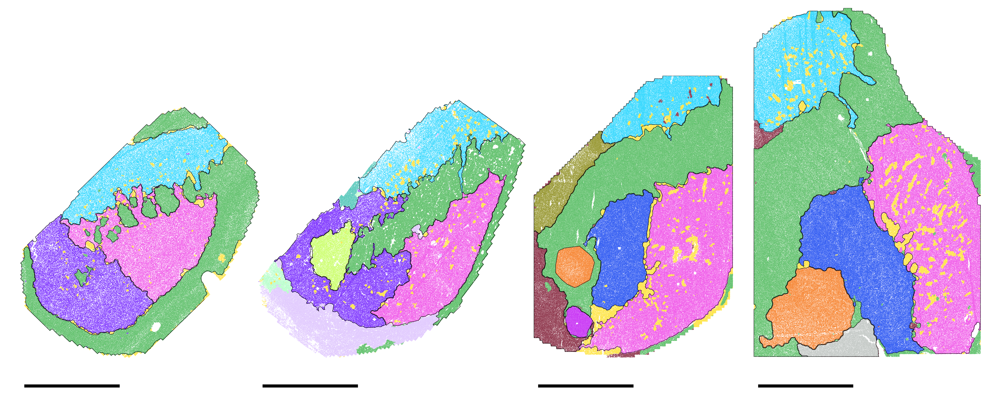

In [11]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import os
import copy 
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
backgd_sz = {'Donor_1311_posterior':0.025,'Donor_2724_anterior':0.05,'Donor_2724_posterior':0.03,'Donor_3924_anterior':0.05}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}


fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
bbox = fig.get_tightbbox()
ax = None

samples = ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']
figure_title = 'Global_SpatialModule_spatialplots_BNSTCorrected'
for i,sample in enumerate(samples):
    cond = adata.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = adata[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample])
    cnt = copy.deepcopy(sptial_module_dict[sample])
    strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
    
    for label_ in cnt:
        if isinstance(cnt[label_],list):
            for i in range(len(cnt[label_])):
                cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
        else:   
            cnt[label_] = rotate(cnt[label_],rot_deg[sample])
    for idx in range(len(strio_cnt)):
        strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

    if reverse_coord[sample]:
        X_sample = X_sample[:,::-1]
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = cnt[label_][i][:,::-1]
            else:
                cnt[label_] = cnt[label_][:,::-1]
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = strio_cnt[idx][:,::-1]

    adata.obs.loc[cond,['x','y']] = X_sample.copy()
    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    if ax != None:
        bbox = ax.get_position()
    dx = dx/figsize_scale
    dy = dy/figsize_scale
    # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
    dx_frac = dx/fig.get_figwidth()
    dy_frac = dy/fig.get_figheight()
    width_gap = 1
    if i < 2:
        width_gap = 0.9
        # point_sz_map[all_clusters_plot[0]] = 1
        # point_sz_map[all_clusters_plot[1]] = 1
        # point_sz_map[all_clusters_plot[2]] = 1
    elif i < 3:
        width_gap = 0.95

    ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
    sns.scatterplot(x =adata.obs.loc[cond,'x'] , y = adata.obs.loc[cond,'y']  ,ax = ax, s = 0.005, color = 'gray')
    
    for module in np.unique(adata.obs.loc[cond,'Final_Major_region_label']):
        # plot matrix 
        keep_region = adata.obs['Final_Major_region_label'].isin([module])
        sns.scatterplot(x =adata.obs.loc[cond & keep_region,'x'] , y = adata.obs.loc[cond & keep_region,'y']  ,ax = ax, s = 0.1, color = cluster_cmap[module])


    # add the outregion outlines 
    for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
        if label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 0.3, c = 'k')
            else:
                ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 0.3, c = 'k')
                
    # add the striosome contour outline
    # for cnt in strio_cnt:
    #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

    # Set the axis limits 
    xmax, ymax = X_sample.max(axis=0)
    xmin, ymin = X_sample.min(axis=0)
    # ax.set_xlim([xmin,xmax])
    ax.set_ylim([ymin,ymax + 3500])
    # add scale bar
    if sample == 'Donor_2724_anterior':
        scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
    else:    
        scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')

    ax.add_patch(scalebar)

    if invert_xaxis[sample]:
        ax.invert_xaxis()
    
    if invert_yaxis[sample]:
        ax.invert_yaxis()
    ax.set_axis_off()

    # ax.set_aspect('equal', adjustable ='datalim')
    # if i == 0:
    #     # ax.text(xmin + 0.7*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{cluster_}', fontsize = 25)
    #     ax.text(xmin + 0.2*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{figure_title}', fontsize = 25)

plt.savefig(r'./figures/GlobalSpatialModule_Focus_Figure' + os.sep + figure_title + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/GlobalSpatialModule_Focus_Figure' + os.sep + figure_title + '.tif',bbox_inches = 'tight')

plt.show()

### 2. Quantification of cell type proportion per brain region. 

**NOTE:** the fraction of MSN will be within each region 

a. Proporition of MSN per brain region

In [10]:
MSN_types = [nm for nm in np.unique(adata.obs['Group_name']) if 'msn' in nm.lower()]
MSN_types

['STR D1D2 Hybrid MSN',
 'STRd D1 Matrix MSN',
 'STRd D1 Striosome MSN',
 'STRd D2 Matrix MSN',
 'STRd D2 StrioMat Hybrid MSN',
 'STRd D2 Striosome MSN',
 'STRv D1 MSN',
 'STRv D1 NUDAP MSN',
 'STRv D2 MSN']

In [11]:
import pandas as pd
adata_obs_MSN = adata[adata.obs['Group_name'].isin(MSN_types)].obs
brain_regions = np.unique(adata.obs['Final_Major_region_label'])
MSNfraction_preregion = []
for ROI in brain_regions:
    region_keep = adata_obs_MSN['Final_Major_region_label'].isin([ROI])
    count_df = adata_obs_MSN[region_keep]['Group_name'].value_counts(normalize = True)
    count_df = count_df.to_frame().rename(columns = {'proportion':ROI})
    MSNfraction_preregion +=[count_df]
MSNfraction_preregion = pd.concat(MSNfraction_preregion, axis = 1)


- Plot as stacked horizontal barplot

In [ ]:
celltype_cluster_cmap = np.load(r'./cluster_cmap_final_updated_9172025.npy',allow_pickle = True).item()

In [13]:
# sort the matrix/ dataframe based on celltypes abundent in pu/ca
sortidx = np.argsort(MSNfraction_preregion['Putamen'])[::-1]
MSNfraction_preregion = MSNfraction_preregion.iloc[sortidx,:].copy()

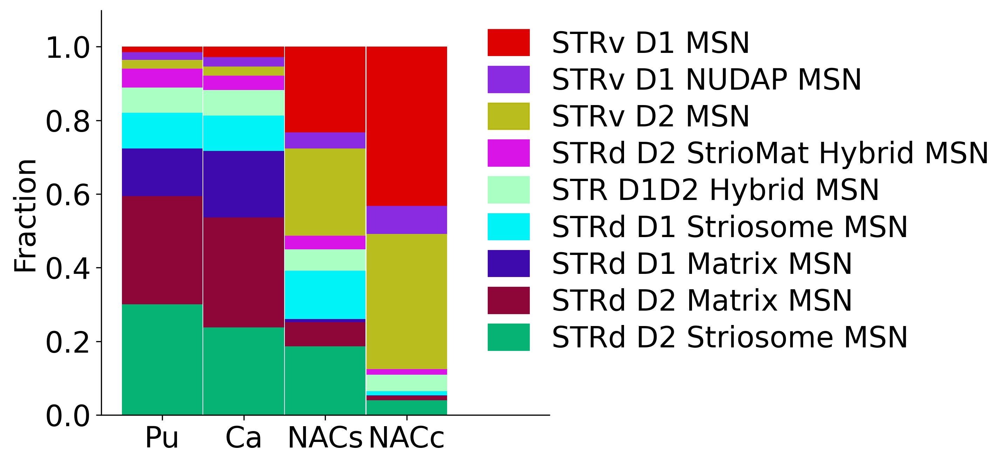

In [16]:
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['font.size'] = 20

figure_title = 'MSN_proportion_per_spatialModule'

fig,ax = plt.subplots(1,1, dpi = 300, figsize = (5.5,5))
# regions = np.array(MSNfractioon_perregion_.columns)
regions = ['Putamen','Caudate','NAC_shell','NAC_core']
regions_label = ['Pu','Ca','NACs','NACc']
width = 0.99
bottom = np.zeros(len(regions))

for type_ in MSNfraction_preregion.index:
    vals = MSNfraction_preregion.loc[type_,regions].values
    ax.bar(regions_label, vals, bottom = bottom, width = width,color = celltype_cluster_cmap[type_])
    bottom += vals

ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])

ax.set_ylabel('Fraction', fontdict={'fontsize': 20})

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 20, labelrotation = 0)
# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(MSNfraction_preregion.index):
    rec = patches.Rectangle([bbox.xmin +  5*bbox.width , 0.2*bbox.ymax + i* 0.1] , 0.5,0.07, color = celltype_cluster_cmap[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin +  6*bbox.width , (0.2*bbox.ymax + i* 0.1) + 0.03,type_,va = 'center')
plt.savefig(r'./figures/GlobalSpatialModule_Focus_Figure' + os.sep + figure_title + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/GlobalSpatialModule_Focus_Figure' + os.sep + figure_title + '.tif',bbox_inches = 'tight')
plt.show()



b. Proportition of CGE and MGE interneurons

In [100]:
np.unique(adata.obs['Class_name'])

array(['Astro-Epen', 'CN CGE GABA', 'CN GABA-Glut', 'CN LGE GABA',
       'CN MGE GABA', 'Cx GABA', 'F M GABA', 'F M Glut', 'Immune',
       'M Dopa', 'OPC-Oligo', 'Vascular'], dtype=object)

In [104]:
np.unique(adata[adata.obs['Class_name'].isin(['CN MGE GABA','CN CGE GABA'])].obs['Group_name'])

array(['GPin-BF Cholinergic GABA', 'LAMP5-CXCL14 GABA', 'LAMP5-LHX6 GABA',
       'STR Cholinergic GABA', 'STR FS PTHLH-PVALB GABA',
       'STR LYPD6-RSPO2 GABA', 'STR SST-ADARB2 GABA',
       'STR SST-CHODL GABA', 'STR SST-RSPO2 GABA', 'STR TAC3-PLPP4 GABA',
       'STR-BF TAC3-PLPP4-LHX8 GABA', 'STRd Cholinergic GABA', 'VIP GABA'],
      dtype=object)

In [105]:
import pandas as pd
adata_obs_GABAergic = adata[adata.obs['Class_name'].isin(['CN MGE GABA','CN CGE GABA'])].obs
brain_regions = np.unique(adata.obs['Final_Major_region_label'])
GABA_fraction_preregion = []
for ROI in brain_regions:
    region_keep = adata_obs_GABAergic['Final_Major_region_label'].isin([ROI])
    count_df = adata_obs_GABAergic[region_keep]['Group_name'].value_counts(normalize = True)
    count_df = count_df.to_frame().rename(columns = {'proportion':ROI})
    GABA_fraction_preregion +=[count_df]
GABA_fraction_preregion = pd.concat(GABA_fraction_preregion, axis = 1)


In [116]:
# sort the dataframe into most abudent cell types 
sortidx = np.argsort(np.mean(GABA_fraction_preregion.values, axis = -1))[::-1]
GABA_fraction_preregion = GABA_fraction_preregion.iloc[sortidx].copy()

In [117]:
brain_regions

array(['BNST', 'Caudate', 'Ependymal_zone', 'Gpe', 'Gpi',
       'GrayMatter_fibers', 'Internal_Capsule', 'IsCj', 'NAC_core',
       'NAC_shell', 'Putamen', 'Thalamus', 'anterior_commissure',
       'whitematter(Olfactory area)'], dtype=object)

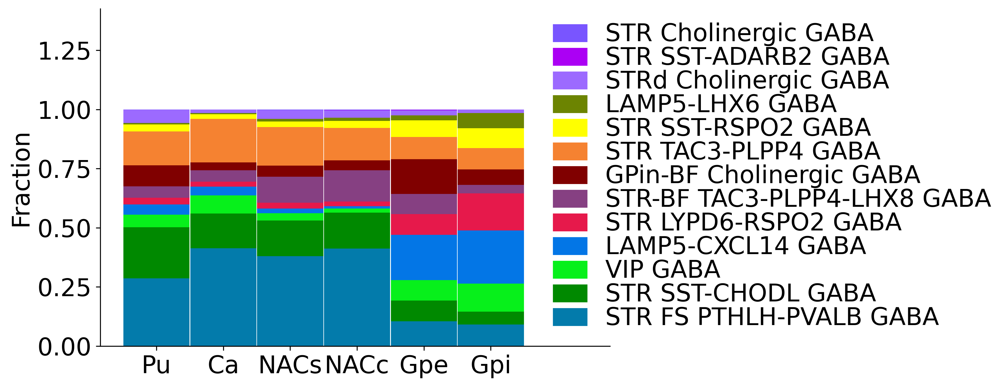

In [120]:
import matplotlib as mpl
mpl.rcParams['font.size'] = 20

fig,ax = plt.subplots(1,1, dpi = 300, figsize = (7.5,5))
# regions = np.array(MSNfractioon_perregion_.columns)
regions = ['Putamen','Caudate','NAC_shell','NAC_core','Gpe', 'Gpi']
regions_label = ['Pu','Ca','NACs','NACc','Gpe', 'Gpi']
width = 0.99
bottom = np.zeros(len(regions))

for type_ in GABA_fraction_preregion.index:
    vals = GABA_fraction_preregion.loc[type_,regions].values
    ax.bar(regions_label, vals, bottom = bottom, width = width,color = celltype_cluster_cmap[type_])
    bottom += vals

ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])

ax.set_ylabel('Fraction', fontdict={'fontsize': 20})

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 20, labelrotation = 0)
# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(GABA_fraction_preregion.index):
    rec = patches.Rectangle([bbox.xmin +  7.5*bbox.width , 0.1*bbox.ymax + i* 0.1] , 0.5,0.07, color = celltype_cluster_cmap[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin +  8.5*bbox.width , (0.1*bbox.ymax + i* 0.1) + 0.03,type_,va = 'center')
plt.show()



### 3. Spatial plot of Selected cell types

In [10]:
def plot_cluster_scdata(scdata,cmap,all_clusters,clusters=[1,2],bg_color = 'gray',bg_pt_size = 5, point_sz_map = None, transpose=1,flipx=1,flipy=1,hue_input = 'leiden' , ax = None,use_seaborn = False,show_title = True):
    """
    plot spatial location of cell cluster using either seaborn or matplotlib
    use seaborn for individual clusters
    use matplotlib scatter function to visualize all clusters
    cmap - dictionary that has color of each cluster  used in umap
    """
    fig = None
    if not ax:
     fig,ax = plt.subplots(figsize=(15, 15),)# facecolor="black")

    
    if use_seaborn:
        x,y,hue = 'x', 'y',hue_input
        sns.scatterplot(x=x, y=y, data=scdata.obs, 
                        s=bg_pt_size, markers=dict(marker_edge_color='none'),
                        rasterized=True,
                        ax=ax,c= bg_color)
    else: # use matplotlib
        x,y = (np.array(scdata.obs[['x', 'y']])*[flipx,flipy])[:,::transpose].T
        ax.scatter(x, y, c=bg_color, s = bg_pt_size, marker='.')
        
    for cluster in clusters:
        clst_idx = all_clusters.index(cluster)
        cluster_ = str(cluster)
        inds = scdata.obs[hue_input] == cluster_
        
        #col = cmap[int(clst_idx) % len(cmap)]
        col = cmap[cluster_] # cmap is dictionary
        point_sz = point_sz_map[cluster_] # point size dictionary
        if use_seaborn:
            sns.scatterplot(x=x, y=y, data=scdata.obs[inds], 
                        s=point_sz, markers=dict(marker_edge_color=col),
                        rasterized=True,
                        ax=ax,c= col)
            if show_title:
                ax.set_title(f'cluster {cluster_}',fontsize = 7, y= 1)
        else:
            x_ = x[inds]
            y_ = y[inds]
            ax.scatter(x_, y_, c=col, s= point_sz, marker='.',label = cluster_)
        
        
    
    # ax.set_xlim([x.min(),x.max()])
    # ax.set_ylim([y.min(),y.max()])
    ax.grid(False)
    ax.axis("off")
    ax.axis("equal")
    if fig:
        ax.legend( loc = 'lower center', ncol = len(clusters)//3,markerscale = 12, title = 'Clusters',facecolor = 'black',
            labelcolor = 'white')
        ax.set_title(np.unique(scdata.obs['sample'])[0])
    else:
        # ax.legend( loc = 'lower center')
        pass
        
    ax.autoscale(enable=True, tight=True)
    
   

In [11]:
import seaborn as sns
import matplotlib.patches as patches
import os
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 

adata.obs[['x','y']] = adata.obsm['X_spatial'].copy()
figsize_scale = 8e3

dx_list = []
dy_list = []
samples = np.unique(adata.obs['samples'])
for i,sample in enumerate(samples):
    cond = adata.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = adata[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample]) # since rotation is could change the xy limit, perform rotation to get accurate estiamte

    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    dx_list += [dx/figsize_scale]
    dy_list += [dy/figsize_scale]
dx_max = np.max(dx_list)  
dy_max = np.max(dy_list)  
print(f'max-width:{dx_max}, max-height:{dy_max}')

max-width:3.4967735624804646, max-height:4.602798834741115


In [12]:
cluster_cmap = np.load(r'./cluster_cmap_final_updated_9172025.npy', allow_pickle=True).item()

In [13]:
all_clusters = np.unique(adata.obs['Group_name']).tolist()
clusters_curated = [ 

# +++++++++++++ Oligo +++++++++++++++++++++++
'ImOligo','Oligo OPALIN', 'Oligo PLEKHG1',
'COP',
'OPC',
 
# # glia (Astro-Ependy-Immune)
 'Astrocyte',
  'Ependymal',
  'ImAstro',
 'B cells',
 'BAM',
 'Endo',
'VLMC',
'Pericyte',
 'SMC',

# # # ++++++++++++++++ Gp cells  +++++++++++++++++++
 'GPe MEIS2-SOX6 GABA',
 'GPe SOX6-CTXND1 GABA',
 'GPe-NDB-SI LHX6-LHX8-GBX1 GABA',
 'GPi Core',
 'GPi Shell',
 'GPin-BF Cholinergic GABA',

# # +++++++++++++++++ MSN ++++++++++++++++++++++++++++++++
    'STR D1D2 Hybrid MSN',
    'STRd D2 StrioMat Hybrid MSN',
    'STRv D1 NUDAP MSN',
    'STRd D2 Striosome MSN',
    'STRd D2 Matrix MSN',
    'STRd D1 Striosome MSN',
    'STRd D1 Matrix MSN',
    'STRv D2 MSN',
    'STRv D1 MSN',
    
    

    ]

remaining_clusters  = list(set(all_clusters).difference(clusters_curated))

all_clusters = remaining_clusters + clusters_curated

In [14]:
point_sz_map = { 'Oligo OPALIN': 0.2,
                 'Oligo PLEKHG1': 0.5,
                  'COP':0.5,
                  'ImOligo':0.2,
                  'OPC': 0.5,
                'STR D1D2 Hybrid MSN': 2,
                'STRd D2 StrioMat Hybrid MSN': 2,
                'STRv D1 NUDAP MSN':2,
                 'STRd D2 Striosome MSN':1,
                 'STRd D1 Striosome MSN':1,
                 'STRd D2 Matrix MSN':2,
                 'STRd D1 Matrix MSN':2,
                 'STRv D1 MSN':2,
                 'STRv D2 MSN':2,
                  'GPi Core':4,
                  'GPi Shell':4,
                   'GPe SOX6-CTXND1 GABA':2,
                   'GPe MEIS2-SOX6 GABA':2,
                   'GPe-NDB-SI LHX6-LHX8-GBX1 GABA':2,
                    'GPin-BF Cholinergic GABA':2,
                   
                    # glia (Astro-Ependy-Immune)
                    'Astrocyte':0.2,
                    'Ependymal':0.2,
                    'ImAstro':0.2,
                    'B cells':0.2,
                    'BAM':0.2,
                    'Endo':0.2,
                    'VLMC': 1,
                     'Pericyte': 0.5,
                     'SMC': 1

                    
                 }

point_sz_map.update({clst:4 for clst in remaining_clusters})

In [15]:
np.unique(adata.obs['Group_name'])

array(['AMY-SLEA-BNST D1 GABA', 'AMY-SLEA-BNST GABA', 'Astrocyte',
       'B cells', 'BAM', 'BF SKOR1 Glut', 'COP', 'Endo', 'Ependymal',
       'GPe MEIS2-SOX6 GABA', 'GPe SOX6-CTXND1 GABA',
       'GPe-NDB-SI LHX6-LHX8-GBX1 GABA', 'GPi Core', 'GPi Shell',
       'GPin-BF Cholinergic GABA', 'ImAstro', 'ImOligo',
       'LAMP5-CXCL14 GABA', 'LAMP5-LHX6 GABA', 'Microglia', 'Monocyte',
       'OB Dopa-GABA', 'OB FRMD7 GABA', 'OPC', 'OT D1 ICj',
       'Oligo OPALIN', 'Oligo PLEKHG1', 'Pericyte', 'SMC', 'SN EBF2 GABA',
       'SN GATA3-PVALB GABA', 'SN SEMA5A GABA', 'SN SOX6 Dopa',
       'SN-VTR CALB1 Dopa', 'SN-VTR GAD2 Dopa',
       'SN-VTR-HTH GATA3-TCF7L2 GABA', 'STH PVALB-PITX2 Glut',
       'STR Cholinergic GABA', 'STR D1D2 Hybrid MSN',
       'STR FS PTHLH-PVALB GABA', 'STR LYPD6-RSPO2 GABA',
       'STR SST-ADARB2 GABA', 'STR SST-CHODL GABA', 'STR SST-RSPO2 GABA',
       'STR TAC3-PLPP4 GABA', 'STR-BF TAC3-PLPP4-LHX8 GABA',
       'STRd Cholinergic GABA', 'STRd D1 Matrix MSN',
   

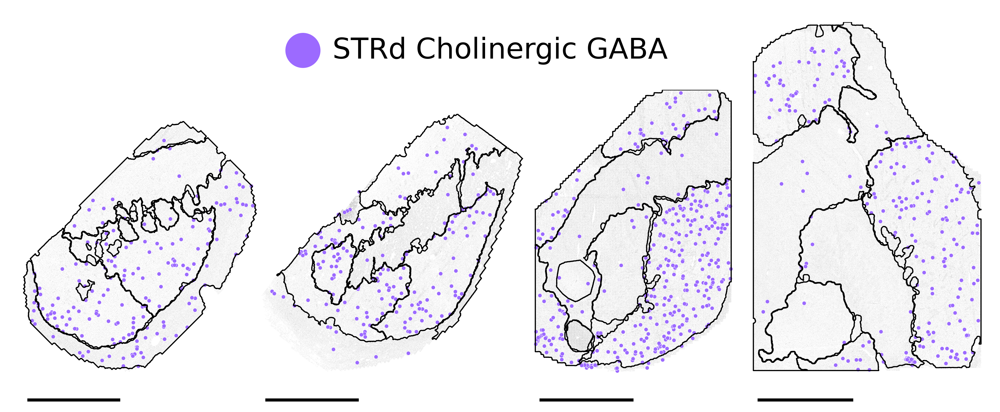

In [18]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 

rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
# backgd_sz = {'Donor_1311_posterior':0.025,'Donor_2427_anterior':0.05,'Donor_2427_posterior':0.03,'Donor_3924_anterior':0.05}
backgd_sz = {'Donor_1311_posterior':0.005,'Donor_2724_anterior':0.005,'Donor_2724_posterior':0.005,'Donor_3924_anterior':0.005}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}

# all_clusters_plot = ['GPe-NDB-SI LHX6-LHX8-GBX1 GABA', 'SN-VTR-HTH GATA3-TCF7L2 GABA','STR FS PTHLH-PVALB GABA', 'STR-BF TAC3-PLPP4-LHX8 GABA','STRd D2 StrioMat Hybrid MSN']
# all_clusters_plot = ['STR FS PTHLH-PVALB GABA']
# point_sz_map[all_clusters_plot[-1]] = 4
all_clusters_plot = ['STRd Cholinergic GABA']
point_sz_map[all_clusters_plot[-1]] = 12
for cluster_ in all_clusters_plot:#allneuron_clusters:
     
    fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
    bbox = fig.get_tightbbox()
    ax = None

    samples = ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']
    # samples = ['Donor_2427_posterior','Donor_1311_posterior']
    figure_title = 'STR_FS_PTHLH_PVALB_GABA'
    for sampleIdx,sample in enumerate(samples):
        cond = adata.obs['samples'] == sample
        # adjucent the spatial coordinate 
        X_sample = adata[cond].obsm['X_spatial'].copy()
        X_sample = rotate(X_sample,rot_deg[sample])
        cnt = copy.deepcopy(sptial_module_dict[sample])
        strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
        
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
            else:   
                cnt[label_] = rotate(cnt[label_],rot_deg[sample])
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

        if reverse_coord[sample]:
            X_sample = X_sample[:,::-1]
            for label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cnt[label_][i] = cnt[label_][i][:,::-1]
                else:
                    cnt[label_] = cnt[label_][:,::-1]
            for idx in range(len(strio_cnt)):
                strio_cnt[idx] = strio_cnt[idx][:,::-1]

        adata.obs.loc[cond,['x','y']] = X_sample.copy()
        # idenity the proprotion betwen the width and height of the sample
        dx,dy = np.abs(np.ptp(X_sample, axis = 0))
        if ax != None:
            bbox = ax.get_position()
        dx = dx/figsize_scale
        dy = dy/figsize_scale
        # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
        dx_frac = dx/fig.get_figwidth()
        dy_frac = dy/fig.get_figheight()
        width_gap = 1
        if sampleIdx < 2:
            width_gap = 0.9
        elif sampleIdx < 3:
            width_gap = 0.95

        ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
        plot_cluster_scdata(adata[cond],cluster_cmap,all_clusters = [cluster_],clusters = [cluster_],bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map, transpose=1,flipx=1,flipy=1,hue_input = 'Group_name' , ax = ax,use_seaborn = True,show_title = False )

        # add the outregion outlines 
        for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
            if label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 1, c = 'k')
                else:
                    ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 1, c = 'k')
        # add the striosome contour outline
        # for cnt in strio_cnt:
        #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

        # Set the axis limits 
        xmax, ymax = X_sample.max(axis=0)
        xmin, ymin = X_sample.min(axis=0)
        # ax.set_xlim([xmin,xmax])
        ax.set_ylim([ymin,ymax + 3500])
        # add scale bar
        # add scale bar
        if sample == 'Donor_2724_anterior':
            scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
        else:    
            scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
        ax.add_patch(scalebar)

        if invert_xaxis[sample]:
            ax.invert_xaxis()
        
        if invert_yaxis[sample]:
            ax.invert_yaxis()
        # ax.set_aspect('equal', adjustable ='datalim')
        if sampleIdx == 0:
            # create axis to put the title and text 
            bbox = ax.get_position()
            legend_ax = fig.add_axes([bbox.xmin + 0.6*bbox.width, bbox.ymin + 1.1*bbox.height, 1.2*bbox.width, 0.3*bbox.height])
            # add circle patche
            color_rec = patches.Circle([0.25,0.5],0.2, color = cluster_cmap[cluster_])
            legend_ax.add_patch(color_rec)
            legend_ax.set_aspect('equal',adjustable='box')
            legend_ax.text(0.6, 0.5, f'{cluster_}', fontsize = 25, color = 'k', va = 'center')
            legend_ax.set_axis_off()
            
            
            # ax.text(xmin + 0.4*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{cluster_}', fontsize = 25, color = 'k')
            # add rec to show the color 
            
        #     ax.text(xmin + 0.2*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{figure_title}', fontsize = 25)

    file_name = '_'.join([x for x in f'{cluster_}'.replace(' ','_').split('-') ])
    plt.savefig(r'./figures/GlobalSpatialModule_Focus_Figure' + os.sep + file_name + '.png',bbox_inches = 'tight')
    plt.savefig(r'./figures/GlobalSpatialModule_Focus_Figure' + os.sep + file_name + '.tif',bbox_inches = 'tight')

    plt.show()

### 4. Plot showing the comparision between NAC-shell and NAC-Core

A. D1/D2 STRv MSN and STRd Striosome  cells spatial distribution 

In [15]:
np.unique(adata.obs['Group_name'])

array(['AMY-SLEA-BNST D1 GABA', 'AMY-SLEA-BNST GABA', 'Astrocyte',
       'B cells', 'BAM', 'BF SKOR1 Glut', 'COP', 'Endo', 'Ependymal',
       'GPe MEIS2-SOX6 GABA', 'GPe SOX6-CTXND1 GABA',
       'GPe-NDB-SI LHX6-LHX8-GBX1 GABA', 'GPi Core', 'GPi Shell',
       'GPin-BF Cholinergic GABA', 'ImAstro', 'ImOligo',
       'LAMP5-CXCL14 GABA', 'LAMP5-LHX6 GABA', 'Microglia', 'Monocyte',
       'OB Dopa-GABA', 'OB FRMD7 GABA', 'OPC', 'OT D1 ICj',
       'Oligo OPALIN', 'Oligo PLEKHG1', 'Pericyte', 'SMC', 'SN EBF2 GABA',
       'SN GATA3-PVALB GABA', 'SN SEMA5A GABA', 'SN SOX6 Dopa',
       'SN-VTR CALB1 Dopa', 'SN-VTR GAD2 Dopa',
       'SN-VTR-HTH GATA3-TCF7L2 GABA', 'STH PVALB-PITX2 Glut',
       'STR Cholinergic GABA', 'STR D1D2 Hybrid MSN',
       'STR FS PTHLH-PVALB GABA', 'STR LYPD6-RSPO2 GABA',
       'STR SST-ADARB2 GABA', 'STR SST-CHODL GABA', 'STR SST-RSPO2 GABA',
       'STR TAC3-PLPP4 GABA', 'STR-BF TAC3-PLPP4-LHX8 GABA',
       'STRd Cholinergic GABA', 'STRd D1 Matrix MSN',
   

In [17]:
adata.obs['Final_Major_region_label'].unique()

array(['Caudate', 'Putamen', 'BNST', 'Gpi', 'Gpe', 'Internal_Capsule',
       'GrayMatter_fibers', 'anterior_commissure', 'Thalamus',
       'NAC_shell', 'whitematter(Olfactory area)', 'NAC_core', 'IsCj',
       'Ependymal_zone'], dtype=object)

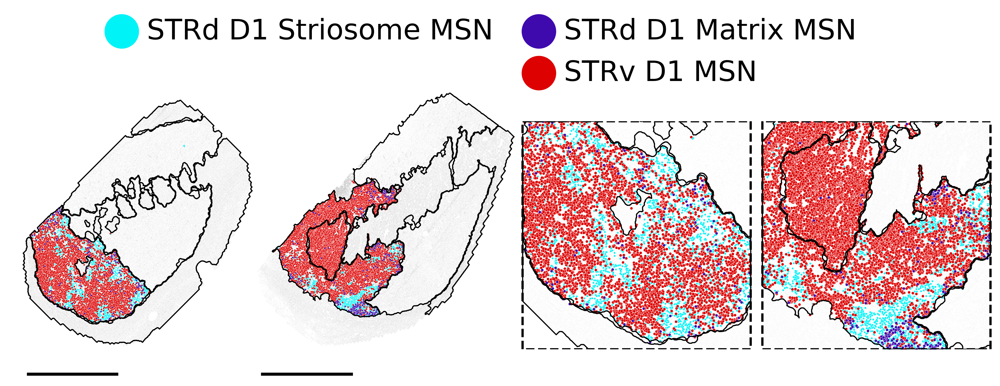

In [29]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 
nobox = True

rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
# backgd_sz = {'Donor_1311_posterior':0.025,'Donor_2427_anterior':0.05,'Donor_2427_posterior':0.03,'Donor_3924_anterior':0.05}
backgd_sz = {'Donor_1311_posterior':0.005,'Donor_2724_anterior':0.005,'Donor_2724_posterior':0.005,'Donor_3924_anterior':0.005}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}

# all_clusters_plot = ['GPe-NDB-SI LHX6-LHX8-GBX1 GABA', 'SN-VTR-HTH GATA3-TCF7L2 GABA','STR FS PTHLH-PVALB GABA', 'STR-BF TAC3-PLPP4-LHX8 GABA','STRd D2 StrioMat Hybrid MSN']
all_clusters_plot = ['STRd D1 Striosome MSN','STRv D1 MSN','STRd D1 Matrix MSN']
point_sz_map[all_clusters_plot[-1]] = 2

fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
bbox = fig.get_tightbbox()
ax = None

samples = ['Donor_3924_anterior','Donor_2724_anterior']
# samples = ['Donor_2427_posterior','Donor_1311_posterior']
figure_title = 'STR_FS_PTHLH_PVALB_GABA'
transformed_Xsample = {}
transformed_module_cnt = {}
transformed_striocnt = {}
for sampleIdx,sample in enumerate(samples):
    cond = adata.obs['samples'] == sample
    spatialModule_cond = adata.obs['Final_Major_region_label'].isin(['NAC_core','NAC_shell'])
    # adjucent the spatial coordinate 
    X_sample = adata[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample])
    cnt = copy.deepcopy(sptial_module_dict[sample])
    strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
    
    for label_ in cnt:
        if isinstance(cnt[label_],list):
            for i in range(len(cnt[label_])):
                cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
        else:   
            cnt[label_] = rotate(cnt[label_],rot_deg[sample])
    for idx in range(len(strio_cnt)):
        strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

    if reverse_coord[sample]:
        X_sample = X_sample[:,::-1]
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = cnt[label_][i][:,::-1]
            else:
                cnt[label_] = cnt[label_][:,::-1]
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = strio_cnt[idx][:,::-1]

    adata.obs.loc[cond,['x','y']] = X_sample.copy()
    # save the transformations 

    transformed_Xsample[sample] = X_sample.copy()
    transformed_module_cnt[sample] = copy.deepcopy(cnt)
    transformed_striocnt[sample] = copy.deepcopy(strio_cnt)


    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    if ax != None:
        bbox = ax.get_position()
    dx = dx/figsize_scale
    dy = dy/figsize_scale
    # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
    dx_frac = dx/fig.get_figwidth()
    dy_frac = dy/fig.get_figheight()
    width_gap = 1
    if sampleIdx < 2:
        width_gap = 0.9
    elif sampleIdx < 3:
        width_gap = 0.95

    ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
    # plot the background cells 
    sns.scatterplot(x =X_sample[:,0] , y =X_sample[:,1] , ax = ax, s = backgd_sz[sample], color = 'gray')
    plot_cluster_scdata(adata[cond & spatialModule_cond],cluster_cmap,all_clusters = all_clusters_plot,clusters = all_clusters_plot,bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map, transpose=1,flipx=1,flipy=1,hue_input = 'Group_name' , ax = ax,use_seaborn = True,show_title = False )

    # add the outregion outlines 
    for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
        if label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 1, c = 'k')
            else:
                ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 1, c = 'k')
    # add the striosome contour outline
    # for cnt in strio_cnt:
    #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

    # Set the axis limits 
    xmax, ymax = X_sample.max(axis=0)
    xmin, ymin = X_sample.min(axis=0)
    # ax.set_xlim([xmin,xmax])
    ax.set_ylim([ymin,ymax + 3500])
    # add scale bar
    # add scale bar
    if sample == 'Donor_2724_anterior':
        scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
    else:    
        scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
    ax.add_patch(scalebar)

    # put zoom-in box on the spatial plot 
    if sample == 'Donor_3924_anterior':
        zoom_bbox = patches.Rectangle([-10000, 10000],11000,-11000,color  ='k', fill = False,lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox)
    else: # if sample == 'Donor_2724_anterior':
        zoom_bbox = patches.Rectangle([12000, 9000],-11000,-11000,color  ='k', fill = False, lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox)

    if invert_xaxis[sample]:
        ax.invert_xaxis()
    
    if invert_yaxis[sample]:
        ax.invert_yaxis()
    # add axes for zoomin view 
    if sampleIdx == len(samples) - 1:
        bbox = ax.get_position()
        zoom1_ax = fig.add_axes([bbox.xmin + 0.97*bbox.width,bbox.ymin + 0.1*bbox.height, 0.8*bbox.width, 0.8*bbox.height])
        zoom2_ax = fig.add_axes([bbox.xmin + 1.8*bbox.width, bbox.ymin + 0.1*bbox.height, 0.8*bbox.width, 0.8*bbox.height])

        # plot the zoom in data 
        #1. Donor_3924_anterior 
        sample = 'Donor_3924_anterior'
        sample_cond = adata.obs['samples'] == sample
        # add the spatial modules  condititon 
        X_sample = transformed_Xsample[sample].copy()
        cond1 = (X_sample[:,0] > -10000) & (X_sample[:,0] < 1000)
        cond2 = (X_sample[:,1] > -1000) & (X_sample[:,1]  < 10000)
        # increase the size of the point 
        point_sz_map_cp = copy.deepcopy(point_sz_map)
        for clst in all_clusters_plot:
            point_sz_map_cp[clst] = 3*point_sz_map_cp[clst]
        
        # plot the background cells 
        sns.scatterplot(x =X_sample[cond1 & cond2,0] , y =X_sample[cond1 & cond2,1] , ax = zoom1_ax, s = backgd_sz[sample], color = 'gray')
        plot_cluster_scdata(adata[sample_cond][cond1 & cond2 & spatialModule_cond[sample_cond]],cluster_cmap,all_clusters = all_clusters_plot,clusters = all_clusters_plot,bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map_cp, transpose=1,flipx=1,flipy=1,hue_input = 'Group_name' , ax = zoom1_ax,use_seaborn = True,show_title = False )
        # add the box ontop to highlight the bbox
        zbbox = patches.Rectangle(list(X_sample[cond1 & cond2].min(axis=0)),*tuple(np.ptp(X_sample[cond1 & cond2],axis = 0)),color  ='k', fill = False, lw = 2, ls = '--')
        zoom1_ax.add_patch(zbbox)

        # add the outregion outlines 
        cnt = transformed_module_cnt[sample]
        for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
            if label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cond1 = (cnt[label_][i][:,0] > -10000) & (cnt[label_][i][:,0] < 1000)
                        cond2 = (cnt[label_][i][:,1] > -1000) & (cnt[label_][i][:,1]  < 10000)
                        zoom1_ax.plot(cnt[label_][i][cond1 & cond2,0],cnt[label_][i][cond1 & cond2,1], lw = 1, c = 'k')
                else:
                    cond1 = (cnt[label_][:,0] > -10000) & (cnt[label_][:,0] < 1000)
                    cond2 = (cnt[label_][:,1] > -1000) & (cnt[label_][:,1]  < 10000)
                    zoom1_ax.plot(cnt[label_][cond1 & cond2,0],cnt[label_][cond1 & cond2,1], lw = 1, c = 'k')

        if invert_xaxis[sample]:
            zoom1_ax.invert_xaxis()
        if invert_yaxis[sample]:
            zoom1_ax.invert_yaxis()
        

        #1. Donor_2724_anterior 
        sample = 'Donor_2724_anterior'
        sample_cond = adata.obs['samples'] == sample
        # add the spatial modules  condititon 
        X_sample = transformed_Xsample[sample].copy()
        cond1 = (X_sample[:,0] > 1000) & (X_sample[:,0] < 12000)
        cond2 = (X_sample[:,1] > -2000) & (X_sample[:,1]  < 9000)
        # plot the background cells 
        sns.scatterplot(x =X_sample[cond1 & cond2,0] , y =X_sample[cond1 & cond2,1] , ax = zoom2_ax, s = backgd_sz[sample], color = 'gray')
        plot_cluster_scdata(adata[sample_cond][cond1 & cond2 & spatialModule_cond[sample_cond]],cluster_cmap,all_clusters = all_clusters_plot,clusters = all_clusters_plot,bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map_cp, transpose=1,flipx=1,flipy=1,hue_input = 'Group_name' , ax = zoom2_ax,use_seaborn = True,show_title = False )
        zbbox = patches.Rectangle(list(X_sample[cond1 & cond2].min(axis=0)),*tuple(np.ptp(X_sample[cond1 & cond2],axis = 0)),color  ='k', fill = False, lw = 2, ls = '--')
        zoom2_ax.add_patch(zbbox)

        # add the outregion outlines 
        cnt = transformed_module_cnt[sample]
        for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
            if label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cond1 = (cnt[label_][i][:,0] > 1000) & (cnt[label_][i][:,0] < 12000)
                        cond2 = (cnt[label_][i][:,1] > -2000) & (cnt[label_][i][:,1]  < 9000)
                        zoom2_ax.plot(cnt[label_][i][cond1 & cond2,0],cnt[label_][i][cond1 & cond2,1], lw = 1, c = 'k')
                else:
                    cond1 = (cnt[label_][:,0] > 1000) & (cnt[label_][:,0] < 12000)
                    cond2 = (cnt[label_][:,1] > -2000) & (cnt[label_][:,1]  < 9000)
                    zoom2_ax.plot(cnt[label_][cond1 & cond2,0],cnt[label_][cond1 & cond2,1], lw = 1, c = 'k')

        if invert_xaxis[sample]:
            zoom2_ax.invert_xaxis()
        if invert_yaxis[sample]:
            zoom2_ax.invert_yaxis()


    # ax.set_aspect('equal', adjustable ='datalim')
    if sampleIdx == 0:
        # create axis to put the title and text 
        bbox = ax.get_position()
        legend_ax = fig.add_axes([bbox.xmin + 0.3*bbox.width, bbox.ymin + 1.03*bbox.height, 3.5*bbox.width, 0.3*bbox.height])
        # add circle patche and text for the 3 cell types 
        for clst_i, clst in enumerate(['STRd D1 Striosome MSN','STRd D1 Matrix MSN','STRv D1 MSN']):
            yfactor = -0.5 if clst == 'STRv D1 MSN' else 0
            xfactor = 1 if clst == 'STRv D1 MSN' else 0
            color_rec = patches.Circle([-4.5 + 5*(clst_i - xfactor),0.72 + yfactor],0.2, color = cluster_cmap[clst])
            legend_ax.add_patch(color_rec)
            legend_ax.text((-4.5 + 5*(clst_i-xfactor)) + 0.3, 0.72 + yfactor, f'{clst}', fontsize = 25, color = 'k', va = 'center')
        legend_ax.set_aspect('equal',adjustable='datalim')
        # legend_ax.set_ylim(-1.3,1)
        legend_ax.set_axis_off()
        


# file_name = '_'.join([x for x in f'{cluster_}'.replace(' ','_').split('-') ])
if not nobox:
    file_name = 'anterior_STRd_Matrix_Striosome_STRV_MSN'
else:
    file_name = 'anterior_STRd_Matrix_Striosome_STRV_MSN_nobox'
plt.savefig(r'./figures/GlobalSpatialModule_Focus_Figure' + os.sep + file_name + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/GlobalSpatialModule_Focus_Figure' + os.sep + file_name + '.tif',bbox_inches = 'tight')

plt.show()

B. Raw transcript plots showing expression of Striosome Marker genes in the striosome

- Load the raw transcript signal the two anteriro sections.

In [4]:
import anndata
import h5py
import json
import numpy as np
import pandas as pd
import pathlib
import scanpy as sc

import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

In [5]:
#### rotate the sections by some degree manually
def rotate(spatial_x,deg):
    """
    spatial_X: Nx2 matrix
    deg: rotation degree in radian
    
    """
    deg = np.deg2rad(deg)
    rotation_mat = np.array([[np.cos(deg),-1*np.sin(deg)],
                            [np.sin(deg),np.cos(deg)]])
    return np.matmul(spatial_x,rotation_mat)

1. Donor 2724 Anterior

In [ ]:
# load the transcript image
import glob,numpy as np
from tqdm import tqdm

fls = glob.glob(r'./../../Raw_custom_MERFISH_Imaging_data/20250430_XXhBG_2724/HumanBG_MERFISH_Filtered_Spots/Conv_zscan__*--spots.npz')
XF=[]
genes=[]

for fl in tqdm(np.sort(fls)[:]):
    XF_ = np.load(fl)['XF']
    genes_ = np.load(fl)['genes']
    XF.append(XF_)
    genes.append(genes_)
XF_2724 =np.concatenate(XF)
genes_2724 = np.concatenate(genes)
R = np.array([[1,0],[0,1]])
XA_2724 = np.dot(XF_2724[:][:,1:3],R)*0.10833 + XF_2724[:][:,-2:][:,::-1]*[1,-1]

100%|██████████| 5146/5146 [05:53<00:00, 14.58it/s]


In [7]:
# 'Donor_3924_anterior'
XA_sample = {'Donor_2724_anterior':XA_2724}
genes_sample = {'Donor_2724_anterior':genes_2724}

2. Donor 3924 anterior 

In [ ]:
# load the transcript image
import glob,numpy as np
from tqdm import tqdm

fls = glob.glob(r'./../../Raw_custom_MERFISH_Imaging_data/20250720_hBG_3924_CaPuNAc/HumanBG_MERFISH_Filtered_Spots/Conv_zscan__*--spots.npz')
XF=[]
genes=[]

for fl in tqdm(np.sort(fls)[:]):
    XF_ = np.load(fl)['XF']
    genes_ = np.load(fl)['genes']
    XF.append(XF_)
    genes.append(genes_)
XF_3924 =np.concatenate(XF)
genes_3924 = np.concatenate(genes)
R = np.array([[1,0],[0,1]])
XA_3924 = np.dot(XF_3924[:][:,1:3],R)*0.10833 + XF_3924[:][:,-2:][:,::-1]*[1,-1]

100%|██████████| 4905/4905 [04:52<00:00, 16.78it/s]


In [9]:
# 
XA_sample.update({'Donor_3924_anterior':XA_3924})
genes_sample.update({'Donor_3924_anterior':genes_3924})

- Load in the spatial module contours

In [ ]:
donor_2427_anterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_2427_anterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_3924_anterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_3924_anterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

- Define selected gene 

In [11]:
gn_cmap = {
'TH': "#1227E1", # marker of striosome both in STRd and STRv
'KIRREL3': "#FFBF00", # marker of matrix both in STRd and STRv

'PDYN': "#dc08f3", # marker of STRV and striosome
'TESPA1': "#006400",# marker of STRd
}
pz_sz = {'TH':0.5,'KIRREL3':0.1,'PDYN':0.2,'TESPA1':0.2}

In [12]:
#### rotate the sections by some degree manually
def rotate(spatial_x,deg):
    """
    spatial_X: Nx2 matrix
    deg: rotation degree in radian
    
    """
    deg = np.deg2rad(deg)
    rotation_mat = np.array([[np.cos(deg),-1*np.sin(deg)],
                            [np.sin(deg),np.cos(deg)]])
    return np.matmul(spatial_x,rotation_mat)

- Define the dimension of the canvas to plot the figures

In [27]:
figsize_scale = 8e3
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample
dx_list = []
dy_list = []
for sampleIdx,sample in enumerate(samples):
        X = XA_sample[sample] # DO not sample the spots to the selected gene yet, use all the coordinate to find the tissue size 
        # adjucent the spatial coordinate 
        if sample == 'Donor_2724_anterior':
            X_rot = rotate(X,(-1*rot_deg[sample] - 8.5)) # the additional -8.5 deg is becase teh adata was initially rotated by this amount. 
        else:
            X_rot = rotate(X,-1*rot_deg[sample])
        dy,dx = np.ptp(X_rot,axis=0)
        dx_list += [dx/figsize_scale]
        dy_list += [dy/figsize_scale]
dx_max = np.max(dx_list)
dy_max = np.max(dy_list)


In [13]:
dx_max = 3.4967735624804646 
dy_max = 4.602798834741115
figsize_scale = 8e3
# dy_max = 3.4967735624804646 
# dx_max = 4.602798834741115

TH and KIRREL3 , markers for Striosome and Matrix

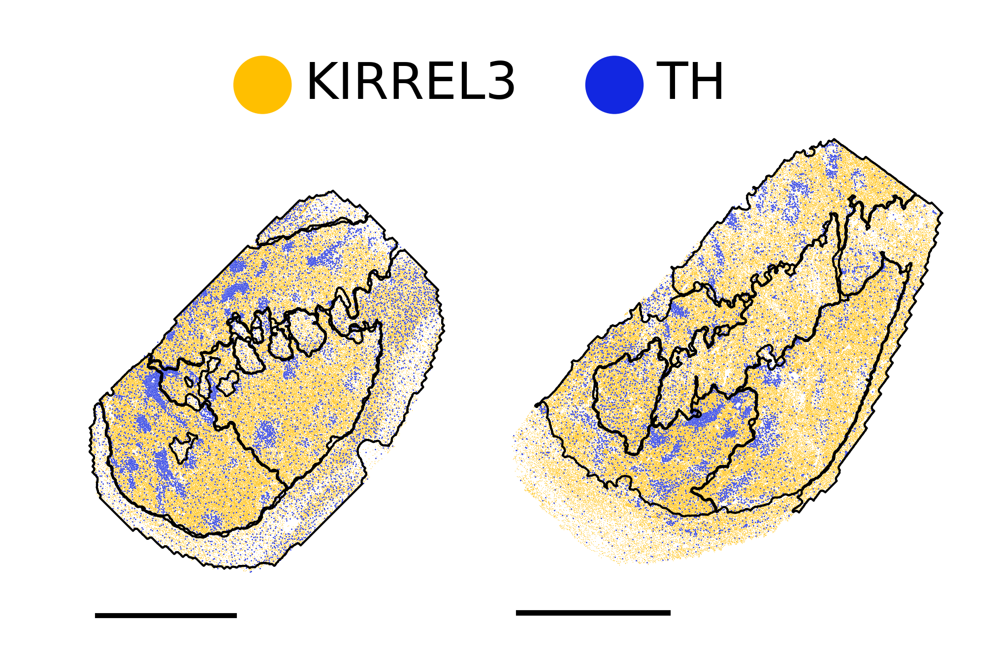

In [ ]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 

rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
# backgd_sz = {'Donor_1311_posterior':0.025,'Donor_2427_anterior':0.05,'Donor_2427_posterior':0.03,'Donor_3924_anterior':0.05}
backgd_sz = {'Donor_1311_posterior':0.005,'Donor_2724_anterior':0.005,'Donor_2724_posterior':0.005,'Donor_3924_anterior':0.005}
# spatial module dictionary
sptial_module_dict = {'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}

     
fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
bbox = fig.get_tightbbox()
ax = None

samples = ['Donor_3924_anterior','Donor_2724_anterior']
figure_title = 'TH_KIRREL3_spatial_plot'
genes_toPlot = ['KIRREL3','TH']
for sampleIdx,sample in enumerate(samples):
    
    for gn_idx,gn in enumerate(genes_toPlot):
        keep = genes_sample[sample] == gn
        X = XA_sample[sample] # DO not sample the spots to the selected gene yet, use all the coordinate to find the tissue size 

        # adjucent the spatial coordinate 
        if sample == 'Donor_2724_anterior':
            X_rot = rotate(X,(-1*rot_deg[sample] - 8.5)) # the additional -8.5 deg is becase teh adata was initially rotated by this amount. 
        else:
            X_rot = rotate(X,-1*rot_deg[sample])

        if reverse_coord[sample]:
            X_rot = X_rot[:,::-1]

        if gn_idx ==0: # need to perform the operation on the spatial module contours only once. 
            cnt = copy.deepcopy(sptial_module_dict[sample])
            strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
            # rotate 
            for label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
                else:   
                    cnt[label_] = rotate(cnt[label_],rot_deg[sample])
            for idx in range(len(strio_cnt)):
                strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])
            # filp horizontally 
            if reverse_coord[sample]:
                for label_ in cnt:
                    if isinstance(cnt[label_],list):
                        for i in range(len(cnt[label_])):
                            cnt[label_][i] = cnt[label_][i][:,::-1]
                    else:
                        cnt[label_] = cnt[label_][:,::-1]
                for idx in range(len(strio_cnt)):
                    strio_cnt[idx] = strio_cnt[idx][:,::-1]
        
        if gn_idx == 0:
            xmax, ymax = X_rot[:,::-1].max(axis=0)
            xmin, ymin = X_rot[:,::-1].min(axis=0)
            dx,dy = np.abs(np.ptp(X_rot[::-1], axis = 0))
            if ax != None:
                bbox = ax.get_position()
            dx = dx/figsize_scale
            dy = dy/figsize_scale
            # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
            dx_frac = dx/fig.get_figwidth()
            dy_frac = dy/fig.get_figheight()
            width_gap = 1
            if sampleIdx < 2:
                width_gap = 0.9
            elif sampleIdx < 3:
                width_gap = 0.85
            # NOTE: we are defining teh axis only once. 
            ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
        
        # Now subset the spots to selected gene 
        X_rot = X_rot[keep][::10,:] # down sample 10x for efficency 
        # plot the genes 
        sns.scatterplot(x = X_rot[:,1],y = X_rot[:,0],
                        s = pz_sz[gn], rasterized = True,
                        ax = ax, c = gn_cmap[gn])
        

    # add the outregion outlines 
    for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
        if label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 1, c = 'k')
            else:
                ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 1, c = 'k')
    # add the striosome contour outline
    # for cnt in strio_cnt:
    #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

    # Set the axis limits 

    # ax.set_xlim([xmin,xmax])
    # ax.set_ylim([ymin,ymax + 3500])
    # add scale bar
    # add scale bar
    if sample == 'Donor_2724_anterior':
        scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
    else:    
        scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
    ax.add_patch(scalebar)

    if invert_xaxis[sample]:
        ax.invert_xaxis()
    
    if invert_yaxis[sample]:
        ax.invert_yaxis()
    # ax.set_axis_off()
    ax.set_aspect('equal', adjustable ='datalim')

    # add axes for zoomin view 
    # if sampleIdx == len(samples) - 1:
    #     bbox = ax.get_position()
    #     zoom1_ax = fig.add_axes([bbox.xmin + 0.97*bbox.width,bbox.ymin + 0.1*bbox.height, 0.8*bbox.width, 0.8*bbox.height])
    #     zoom2_ax = fig.add_axes([bbox.xmin + 1.8*bbox.width, bbox.ymin + 0.1*bbox.height, 0.8*bbox.width, 0.8*bbox.height])


    if sampleIdx == 0:
        bbox = ax.get_position()
        legend_ax = fig.add_axes([bbox.xmin + 0.3*bbox.width, bbox.ymin + 1.03*bbox.height, 1.5*bbox.width, 0.3*bbox.height])
        # add circle patche and text for the plotted genes 
        for gn_i, gn in enumerate(genes_toPlot):
            color_rec = patches.Circle([-1.5 + 2.5*gn_i,0.5],0.2, color = gn_cmap[gn])
            legend_ax.add_patch(color_rec)
            legend_ax.text((-1.5 + 2.5*gn_i) + 0.3, 0.5, f'{gn}', fontsize = 25, color = 'k', va = 'center')
        legend_ax.set_aspect('equal',adjustable='datalim')
        # legend_ax.set_ylim(-1.3,1)
        legend_ax.set_axis_off()
        
    
    # file_name = '_'.join([x for x in f'{cluster_}'.replace(' ','_').split('-') ])
    plt.savefig(r'./figures/GlobalSpatialModule_Focus_Figure' + os.sep + figure_title + '.png',bbox_inches = 'tight')
    plt.savefig(r'./figures/GlobalSpatialModule_Focus_Figure' + os.sep + figure_title + '.tif',bbox_inches = 'tight')

plt.show()

-  Zoom panel for the transcripts

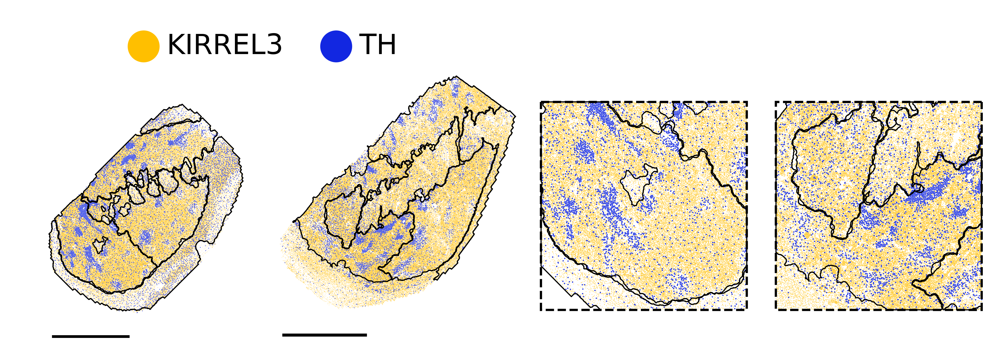

In [29]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 

rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
# backgd_sz = {'Donor_1311_posterior':0.025,'Donor_2427_anterior':0.05,'Donor_2427_posterior':0.03,'Donor_3924_anterior':0.05}
backgd_sz = {'Donor_1311_posterior':0.005,'Donor_2724_anterior':0.005,'Donor_2724_posterior':0.005,'Donor_3924_anterior':0.005}
# spatial module dictionary
sptial_module_dict = {'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}

nobox = True  
fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
bbox = fig.get_tightbbox()
ax = None

samples = ['Donor_3924_anterior','Donor_2724_anterior']
figure_title = 'TH_KIRREL3_spatial_plot_withZoomin'
transformed_Xsample = {}
transformed_module_cnt = {}
transformed_striocnt = {}
genes_toPlot = ['KIRREL3','TH']
for sampleIdx,sample in enumerate(samples):
    
    for gn_idx,gn in enumerate(genes_toPlot):
        keep = genes_sample[sample] == gn
        X = XA_sample[sample] # DO not sample the spots to the selected gene yet, use all the coordinate to find the tissue size 

        # adjucent the spatial coordinate 
        if sample == 'Donor_2724_anterior':
            X_rot = rotate(X,(-1*rot_deg[sample] - 8.5)) # the additional -8.5 deg is becase teh adata was initially rotated by this amount. 
        else:
            X_rot = rotate(X,-1*rot_deg[sample])

        if reverse_coord[sample]:
            X_rot = X_rot[:,::-1]

        if gn_idx ==0: # need to perform the operation on the spatial module contours only once. 
            cnt = copy.deepcopy(sptial_module_dict[sample])
            strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
            # rotate 
            for label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
                else:   
                    cnt[label_] = rotate(cnt[label_],rot_deg[sample])
            for idx in range(len(strio_cnt)):
                strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])
            # filp horizontally 
            if reverse_coord[sample]:
                for label_ in cnt:
                    if isinstance(cnt[label_],list):
                        for i in range(len(cnt[label_])):
                            cnt[label_][i] = cnt[label_][i][:,::-1]
                    else:
                        cnt[label_] = cnt[label_][:,::-1]
                for idx in range(len(strio_cnt)):
                    strio_cnt[idx] = strio_cnt[idx][:,::-1]
        
        if gn_idx == 0:
            xmax, ymax = X_rot[:,::-1].max(axis=0)
            xmin, ymin = X_rot[:,::-1].min(axis=0)
            dx,dy = np.abs(np.ptp(X_rot[::-1], axis = 0))
            if ax != None:
                bbox = ax.get_position()
            dx = dx/figsize_scale
            dy = dy/figsize_scale
            # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
            dx_frac = dx/fig.get_figwidth()
            dy_frac = dy/fig.get_figheight()
            width_gap = 1
            if sampleIdx < 2:
                width_gap = 0.9
            elif sampleIdx < 3:
                width_gap = 0.85
            # NOTE: we are defining teh axis only once. 
            ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
        
        # keep copy of the transformed spatial postion of transcripts 
        transformed_Xsample[sample] = X_rot.copy()
        transformed_module_cnt[sample] = copy.deepcopy(cnt)
        transformed_striocnt[sample] = copy.deepcopy(strio_cnt)

        # Now subset the spots to selected gene 
        X_rot = X_rot[keep][::10,:] # down sample 10x for efficency 
        # plot the genes 
        sns.scatterplot(x = X_rot[:,1],y = X_rot[:,0],
                        s = pz_sz[gn], rasterized = True,
                        ax = ax, c = gn_cmap[gn])
        

    # add the outregion outlines 
    for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
        if label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 1, c = 'k')
            else:
                ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 1, c = 'k')
    # add the striosome contour outline
    # for cnt in strio_cnt:
    #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

    # Set the axis limits 

    # ax.set_xlim([xmin,xmax])
    # ax.set_ylim([ymin,ymax + 3500])
    # add scale bar
    # add scale bar
    if sample == 'Donor_2724_anterior':
        scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
    else:    
        scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
    ax.add_patch(scalebar)

    # put zoom-in box on the spatial plot 
    if sample == 'Donor_3924_anterior':
        zoom_bbox = patches.Rectangle([-10000, 10000],11000,-11000,color  ='k', fill = False,lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox)
    else: # if sample == 'Donor_2724_anterior':
        zoom_bbox = patches.Rectangle([12000, 9000],-11000,-11000,color  ='k', fill = False, lw = 2, ls = '--')
        if not nobox:
            ax.add_patch(zoom_bbox)

    if invert_xaxis[sample]:
        ax.invert_xaxis()
    
    if invert_yaxis[sample]:
        ax.invert_yaxis()
    ax.set_axis_off()
    ax.set_aspect('equal', adjustable ='datalim')

    # add axes for zoomin view 
    if sampleIdx == len(samples) - 1:
        bbox = ax.get_position()
        zoom1_ax = fig.add_axes([bbox.xmin + 0.97*bbox.width,bbox.ymin + 0.1*bbox.height, 0.8*bbox.width, 0.8*bbox.height])
        zoom2_ax = fig.add_axes([bbox.xmin + 1.8*bbox.width, bbox.ymin + 0.1*bbox.height, 0.8*bbox.width, 0.8*bbox.height])

        # plot the zoom in data 
        #1. Donor_3924_anterior 
        sample = 'Donor_3924_anterior'
        X_rot = transformed_Xsample[sample].copy()
        cond1 = (X_rot[:,1] > -10000) & (X_rot[:,1] < 1000)
        cond2 = (X_rot[:,0] > -1000) & (X_rot[:,0]  < 10000)
        # increase the size of the point 
        pz_sz_cp = copy.deepcopy(pz_sz)
        for gn in genes_toPlot:
            pz_sz_cp[gn] = 3*pz_sz_cp[gn]
        for gn in genes_toPlot:
            keep = genes_sample[sample] == gn
            X_rot_ = X_rot[keep & cond1 & cond2,:][::10,:] # down sample 10x for efficency 
            # plot the genes 
            sns.scatterplot(x = X_rot_[:,1],y = X_rot_[:,0],
                            s = pz_sz_cp[gn], rasterized = True,
                            ax = zoom1_ax, c = gn_cmap[gn])
        # add the box ontop to highlight the bbox
        zbbox = patches.Rectangle(list(X_rot[keep & cond1 & cond2,::-1].min(axis=0)),*tuple(np.ptp(X_rot[keep & cond1 & cond2,::-1],axis = 0)),color  ='k', fill = False, lw = 2, ls = '--')
        zoom1_ax.add_patch(zbbox)

        # add the outregion outlines 
        cnt = transformed_module_cnt[sample]
        for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
            if label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cond1 = (cnt[label_][i][:,0] > -10000) & (cnt[label_][i][:,0] < 1000)
                        cond2 = (cnt[label_][i][:,1] > -1000) & (cnt[label_][i][:,1]  < 10000)
                        zoom1_ax.plot(cnt[label_][i][cond1 & cond2,0],cnt[label_][i][cond1 & cond2,1], lw = 1, c = 'k')
                else:
                    cond1 = (cnt[label_][:,0] > -10000) & (cnt[label_][:,0] < 1000)
                    cond2 = (cnt[label_][:,1] > -1000) & (cnt[label_][:,1]  < 10000)
                    zoom1_ax.plot(cnt[label_][cond1 & cond2,0],cnt[label_][cond1 & cond2,1], lw = 1, c = 'k')

        if invert_xaxis[sample]:
            zoom1_ax.invert_xaxis()
        if invert_yaxis[sample]:
            zoom1_ax.invert_yaxis()
        zoom1_ax.set_axis_off()
        
        #1. Donor_3924_anterior 
        sample = 'Donor_2724_anterior'
        X_rot = transformed_Xsample[sample].copy()
        cond1 = (X_rot[:,1] > 1000) & (X_rot[:,1] < 12000)
        cond2 = (X_rot[:,0] > -2000) & (X_rot[:,0]  < 9000)
        # increase the size of the point 
        pz_sz_cp = copy.deepcopy(pz_sz)
        for gn in genes_toPlot:
            pz_sz_cp[gn] = 3*pz_sz_cp[gn]
        for gn in genes_toPlot:
            keep = genes_sample[sample] == gn
            X_rot_ = X_rot[keep & cond1 & cond2,:][::10,:] # down sample 10x for efficency 
            # plot the genes 
            sns.scatterplot(x = X_rot_[:,1],y = X_rot_[:,0],
                            s = pz_sz_cp[gn], rasterized = True,
                            ax = zoom2_ax, c = gn_cmap[gn])
        # add the box ontop to highlight the bbox
        zbbox = patches.Rectangle(list(X_rot[keep & cond1 & cond2,::-1].min(axis=0)),*tuple(np.ptp(X_rot[keep & cond1 & cond2,::-1],axis = 0)),color  ='k', fill = False, lw = 2, ls = '--')
        zoom2_ax.add_patch(zbbox)

        # add the outregion outlines 
        cnt = transformed_module_cnt[sample]
        for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
            if label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cond1 = (cnt[label_][i][:,0] > 1000) & (cnt[label_][i][:,0] < 12000)
                        cond2 = (cnt[label_][i][:,1] > -2000) & (cnt[label_][i][:,1]  < 9000)
                        zoom2_ax.plot(cnt[label_][i][cond1 & cond2,0],cnt[label_][i][cond1 & cond2,1], lw = 1, c = 'k')
                else:
                    cond1 = (cnt[label_][:,0] > 1000) & (cnt[label_][:,0] < 12000)
                    cond2 = (cnt[label_][:,1] > -2000) & (cnt[label_][:,1]  < 9000)
                    zoom2_ax.plot(cnt[label_][cond1 & cond2,0],cnt[label_][cond1 & cond2,1], lw = 1, c = 'k')

        if invert_xaxis[sample]:
            zoom2_ax.invert_xaxis()
        if invert_yaxis[sample]:
            zoom2_ax.invert_yaxis()
        zoom2_ax.set_axis_off()



    if sampleIdx == 0:
        bbox = ax.get_position()
        legend_ax = fig.add_axes([bbox.xmin + 0.3*bbox.width, bbox.ymin + 1.03*bbox.height, 1.5*bbox.width, 0.3*bbox.height])
        # add circle patche and text for the plotted genes 
        for gn_i, gn in enumerate(genes_toPlot):
            color_rec = patches.Circle([-1.5 + 2.5*gn_i,0.5],0.2, color = gn_cmap[gn])
            legend_ax.add_patch(color_rec)
            legend_ax.text((-1.5 + 2.5*gn_i) + 0.3, 0.5, f'{gn}', fontsize = 25, color = 'k', va = 'center')
        legend_ax.set_aspect('equal',adjustable='datalim')
        # legend_ax.set_ylim(-1.3,1)
        legend_ax.set_axis_off()
        
    if nobox:
        figure_title = figure_title + '_nobox'
    # # file_name = '_'.join([x for x in f'{cluster_}'.replace(' ','_').split('-') ])
    plt.savefig(r'./figures/GlobalSpatialModule_Focus_Figure' + os.sep + figure_title + '.png',bbox_inches = 'tight')
    plt.savefig(r'./figures/GlobalSpatialModule_Focus_Figure' + os.sep + figure_title + '.tif',bbox_inches = 'tight')

plt.show()